In [1]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os

In [2]:
def lid_pre_process(xyz):
    o =  0 
    if np.size(xyz,1) != 3:
        xyz = np.transpose(xyz)
        
    if np.size(xyz,1) != 3:
        xyz = np.transpose(np.array([xyz[:,0],xyz[:,1],xyz[:,2]]))

    # xyz /= 10

    #lidar_pc = np.transpose(lidar_pc[0:3,:])
    
    #lidar_pc[:,o] = -lidar_pc[:,o] 
    #lidar_pc = np.transpose(np.array([lidar_pc[:,1],lidar_pc[:,0],lidar_pc[:,2]]))
    return xyz

# Project lidar points into camera coordinates
def lidar2cam(lidar_pc,rvec,tvec,intrinsics):
    
    dist_coeffs = np.zeros((4,1)) # Assuming no lens distortion

    lidar_px, _ = cv2.projectPoints(lidar_pc, rvec, tvec, intrinsics, dist_coeffs)
    lidar_px = np.squeeze(lidar_px)
    return lidar_px 




In [3]:
path = '/home/nick/catkin_ws/smartbases/bobby_dat'

# get the information 
images = [ cv2.imread(path + "/Images/" + filename) for filename in os.listdir(path + "/Images/")]

leftlid = [ lid_pre_process(np.loadtxt(path + "/LftLidar/" + filename, delimiter=',')) for filename in os.listdir(path + "/LftLidar/") if ".txt" in filename]
rightlid = [ lid_pre_process(np.loadtxt(path + "/RgtLidar/" + filename, delimiter=',')) for filename in os.listdir(path + "/RgtLidar/") if ".txt" in filename]


focal_length = [606.1387,603.1641]
    
center = [959.0102,599.6154]

intrinsics = np.array([[focal_length[0], 0, center[0]],
                       [0, focal_length[1], center[1]],
                       [0, 0, 1]], dtype = "double"
                       ) 

2526857.683420036 -14349582.528275117 (1200, 1920, 3) (12246, 2)
visible lidar points: (4107, 2)


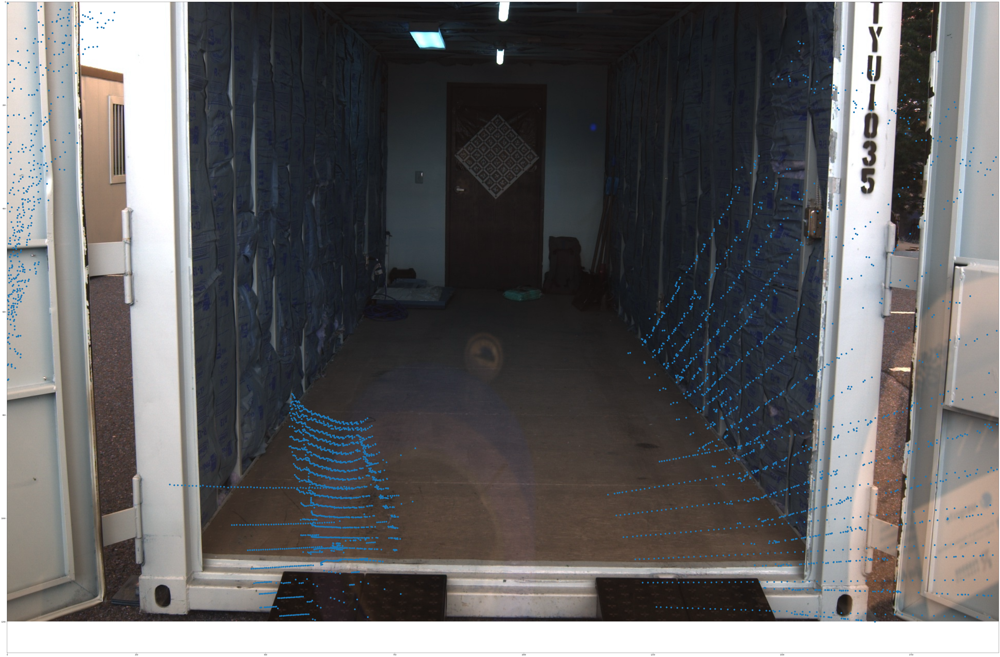

In [11]:
def punchin(img, lidar):
    height = img.shape[0]
    width = img.shape[1]
    trimmed = []
    for point in lidar:
        if point[0] < height and point[1] < width and point[0] > 0 and point[1] > 0:
            trimmed.append(point)
    return np.array(trimmed)

rvec = np.array([[-0.87376982],[-1.02724177],[1.32610297]], dtype="double")
tvec = np.array([[0.45911911],[-0.43532131],[3.22640716]], dtype="double")

index = 2

img = images[index]
pc = leftlid[index]

lidar_pic = lidar2cam(pc, rvec, tvec, intrinsics)
fig, ax = plt.subplots(figsize=(100, 100))
ax.imshow(img)
print(np.amax(lidar_pic), np.amin(lidar_pic), img.shape, lidar_pic.shape)
lidar_pic = punchin(img, lidar_pic)
print("visible lidar points:", lidar_pic.shape)
plt.scatter(lidar_pic[:,1], lidar_pic[:,0], s=80)
